In [1]:
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob as glob
import itertools
import seaborn as sns
from itertools import chain
from tqdm import tqdm, tqdm_notebook, tnrange
from sklearn.metrics import precision_score, accuracy_score, recall_score, confusion_matrix, ConfusionMatrixDisplay
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.models import Sequential, Model, load_model, save_model
from tensorflow.keras.layers import (Conv2D, MaxPooling2D, Dense, Flatten, Activation)
from tensorflow.keras import backend as K

In [2]:
physical_devices = tf.config.list_physical_devices("GPU")
# tf.config.experimental.set_memory_growth(physical_devices[0], True)
physical_devices

[]

In [2]:
data_path = "/kaggle/input/new-plant-diseases-dataset/New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)"
train_path = data_path + "/train"
val_path = data_path + "/valid"
test_path = "/kaggle/input/new-plant-diseases-dataset/test/test"
classes = os.listdir(train_path)
classes

['Tomato___Late_blight',
 'Tomato___healthy',
 'Grape___healthy',
 'Orange___Haunglongbing_(Citrus_greening)',
 'Soybean___healthy',
 'Squash___Powdery_mildew',
 'Potato___healthy',
 'Corn_(maize)___Northern_Leaf_Blight',
 'Tomato___Early_blight',
 'Tomato___Septoria_leaf_spot',
 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot',
 'Strawberry___Leaf_scorch',
 'Peach___healthy',
 'Apple___Apple_scab',
 'Tomato___Tomato_Yellow_Leaf_Curl_Virus',
 'Tomato___Bacterial_spot',
 'Apple___Black_rot',
 'Blueberry___healthy',
 'Cherry_(including_sour)___Powdery_mildew',
 'Peach___Bacterial_spot',
 'Apple___Cedar_apple_rust',
 'Tomato___Target_Spot',
 'Pepper,_bell___healthy',
 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
 'Potato___Late_blight',
 'Tomato___Tomato_mosaic_virus',
 'Strawberry___healthy',
 'Apple___healthy',
 'Grape___Black_rot',
 'Potato___Early_blight',
 'Cherry_(including_sour)___healthy',
 'Corn_(maize)___Common_rust_',
 'Grape___Esca_(Black_Measles)',
 'Raspberry___healthy'

## EDA

In [4]:
train_num, val_num = {}, {}

for each in classes:
    train_num[each] = len(os.listdir(os.path.join(train_path, each)))
    val_num[each] = len(os.listdir(os.path.join(val_path, each)))
img_per_class = pd.DataFrame(train_num.values(), train_num.keys(), columns=["Train Images per Class"])
img_per_class

,Train Images per Class
Tomato___Late_blight,1851
Tomato___healthy,1926
Grape___healthy,1692
Orange___Haunglongbing_(Citrus_greening),2010
Soybean___healthy,2022
Squash___Powdery_mildew,1736
Potato___healthy,1824
Corn_(maize)___Northern_Leaf_Blight,1908
Tomato___Early_blight,1920
Tomato___Septoria_leaf_spot,1745


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


<Axes: title={'center': 'Images per Plant in Train DS'}, xlabel='Plants (Classes)', ylabel='No. of images'>

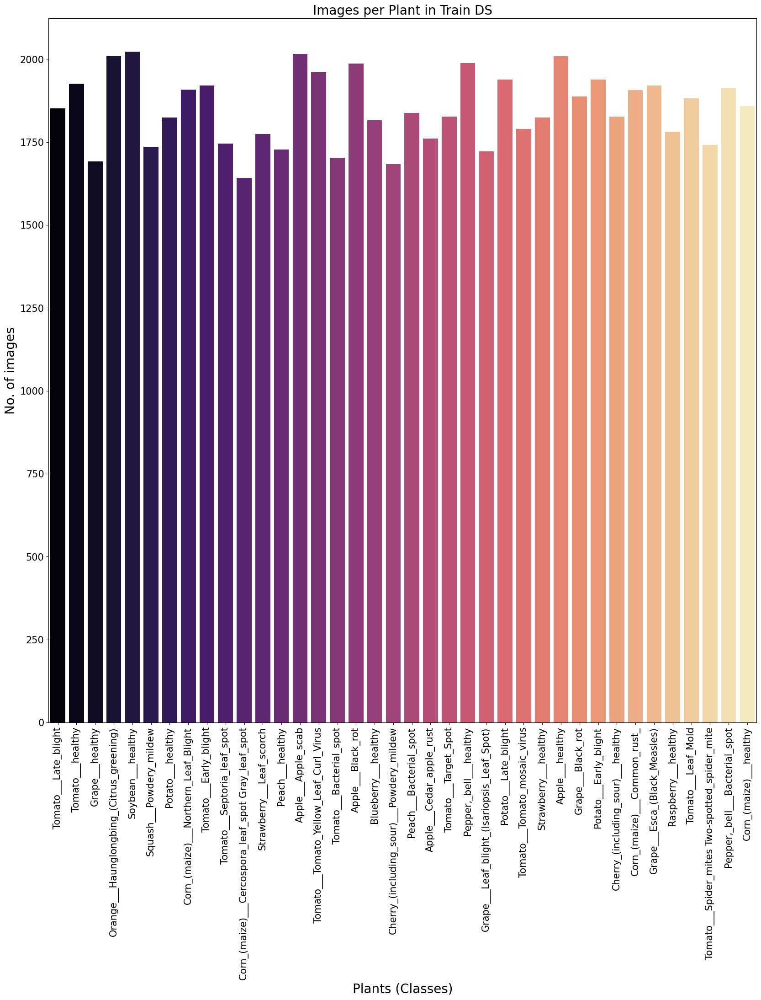

In [4]:
plt.figure(figsize=(20, 20))
plt.xlabel("Plants (Classes)", fontsize=20)
plt.xticks(rotation=90, fontsize=15)
plt.ylabel("No. of images", fontsize=20)
plt.yticks(fontsize=15)
plt.title("Images per Plant in Train DS", fontsize=20)
sns.barplot(x=list(train_num.keys()), y=list(train_num.values()), palette='magma', orient='v')

In [5]:
print(f'All images in train dataset: {sum(train_num.values())}')

All images in train dataset: 70295


In [6]:
val_img_per_class = pd.DataFrame(val_num.values(), val_num.keys(), columns=["Val Images per Class"])
val_img_per_class

,Val Images per Class
Tomato___Late_blight,463
Tomato___healthy,481
Grape___healthy,423
Orange___Haunglongbing_(Citrus_greening),503
Soybean___healthy,505
Squash___Powdery_mildew,434
Potato___healthy,456
Corn_(maize)___Northern_Leaf_Blight,477
Tomato___Early_blight,480
Tomato___Septoria_leaf_spot,436


In [7]:
print(f'All images in validation dataset: {sum(val_num.values())}')

All images in validation dataset: 17572


/opt/conda/lib/python3.10/site-packages/seaborn/_oldcore.py:1765: FutureWarning: unique with argument that is not not a Series, Index, ExtensionArray, or np.ndarray is deprecated and will raise in a future version.
  order = pd.unique(vector)


<Axes: title={'center': 'Image per Plant in Validation DS'}, xlabel='Plants (Classes)', ylabel='No. of Images'>

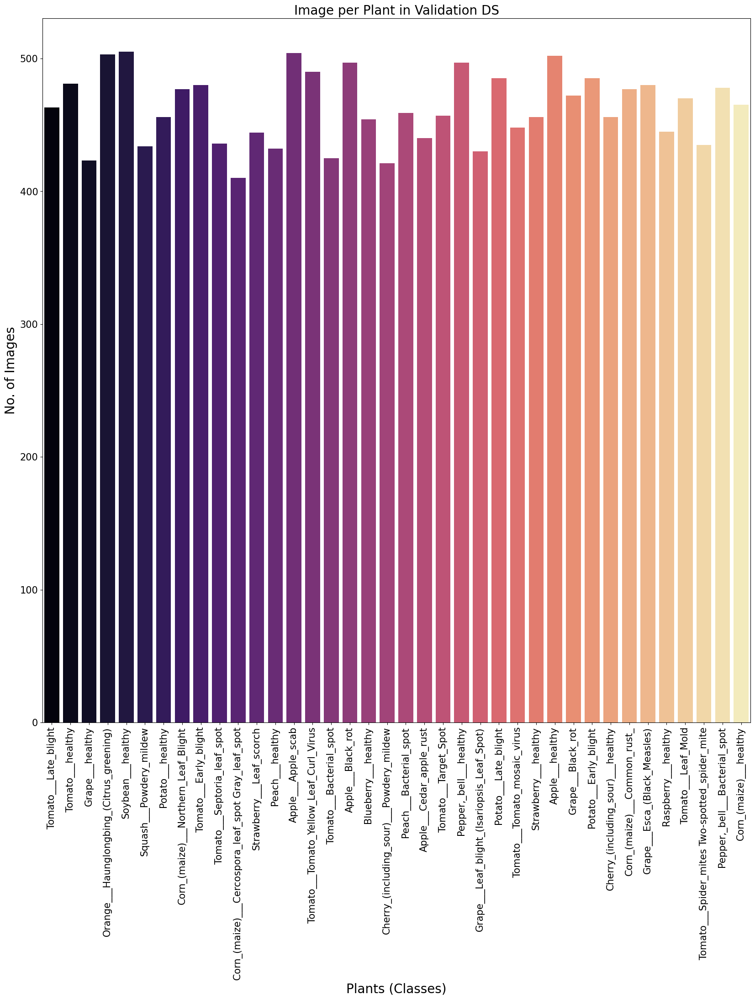

In [8]:
plt.figure(figsize=(20, 20))
plt.xlabel('Plants (Classes)', fontsize=20)
plt.xticks(rotation=90, fontsize=15)
plt.ylabel('No. of Images', fontsize=20)
plt.yticks(fontsize=15)
plt.title('Image per Plant in Validation DS', fontsize=20)
sns.barplot(x=list(val_num.keys()), y=list(val_num.values()), palette='magma', orient='v')

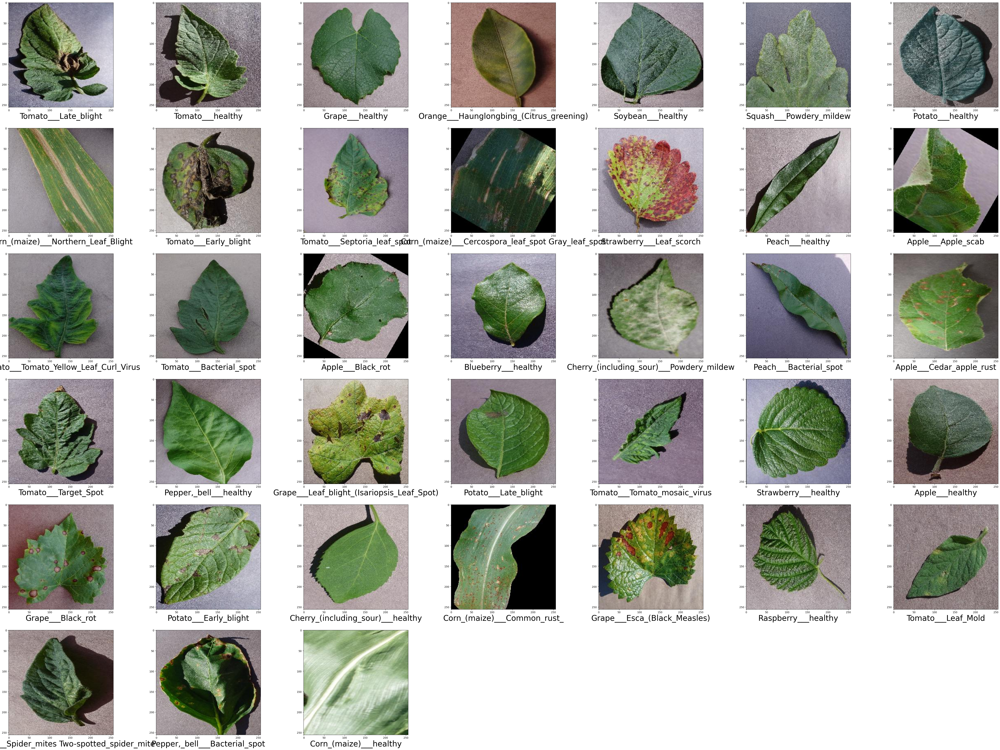

In [9]:
plt.figure(figsize=(70,60))
count = 1
for i in os.listdir(train_path):
    plt.subplot(7,7,count)
    img_path = os.listdir(train_path+"/"+i)
    img_show = plt.imread(train_path+"/"+i+"/"+img_path[0])
    plt.imshow(img_show)
    plt.xlabel(i, fontsize=30)
    count+=1

In [3]:
train_data =keras.utils.image_dataset_from_directory(train_path ,
                                         image_size=(256, 256))
val_data = keras.utils.image_dataset_from_directory(val_path,
                                        image_size=(256, 256))

Found 70295 files belonging to 38 classes.
Found 17572 files belonging to 38 classes.


In [4]:
rescale = keras.layers.Rescaling(scale=1.0/255)

In [5]:
train_gen = train_data.map(lambda image,label:(rescale(image),label))
val_gen  = val_data.map(lambda image,label:(rescale(image),label))
test_gen = val_data.map(lambda image,label:(rescale(image),label))

In [8]:
# train_gen = train_gen.cache().shuffle(1000).prefetch(buffer_size = 1)
# val_gen = val_gen.cache().shuffle(1000).prefetch(buffer_size = 1)
# test_gen = test_gen.cache().shuffle(1000).prefetch(buffer_size = 1)

# CNN Model Structure

In [13]:
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same', input_shape=(256, 256, 3)),
    tf.keras.layers.Conv2D(32, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(3, 3),

    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(64, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(3, 3),

    tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(128, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.MaxPooling2D(3, 3),

    tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(256, (3, 3), activation='relu', padding='same'),

    tf.keras.layers.Conv2D(512, (5, 5), activation='relu', padding='same'),
    tf.keras.layers.Conv2D(512, (5, 5), activation='relu', padding='same'),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(1024, activation='relu'),
    tf.keras.layers.Dropout(.5),

    tf.keras.layers.Dense(38, activation='softmax')
])

lr = 0.0001
model.compile(loss='sparse_categorical_crossentropy',optimizer=keras.optimizers.Adam(learning_rate=lr),
              metrics=["accuracy"])

model.summary()

/opt/conda/lib/python3.10/site-packages/keras/src/layers/convolutional/base_conv.py:99: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 256, 256, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 256, 256, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 85, 85, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 85, 85, 64)     │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 85, 85, 64)     │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 28, 28, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 28, 28, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 28, 28, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 9, 9, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 9, 9, 256)      │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 9, 9, 256)      │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 9, 9, 512)      │     3,277,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 9, 9, 512)      │     6,554,112 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 41472)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1024)           │    42,468,352 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1024)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 38)             │        38,950 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 53,510,982 (204.13 MB)

 Trainable params: 53,510,982 (204.13 MB)

 Non-trainable params: 0 (0.00 B)

In [14]:
history = model.fit(train_gen, validation_data=val_gen, epochs=35, verbose=1)

Epoch 1/35
   1/2197 ━━━━━━━━━━━━━━━━━━━━ 20:28:11 34s/step - accuracy: 0.0625 - loss: 3.6368

I0000 00:00:1709412154.029509      97 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.
W0000 00:00:1709412154.056925      97 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


2197/2197 ━━━━━━━━━━━━━━━━━━━━ 0s 140ms/step - accuracy: 0.1953 - loss: 2.9070

W0000 00:00:1709412461.426480      98 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update
W0000 00:00:1709412463.034706      98 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


2197/2197 ━━━━━━━━━━━━━━━━━━━━ 379s 157ms/step - accuracy: 0.1954 - loss: 2.9066 - val_accuracy: 0.7826 - val_loss: 0.7036
Epoch 2/35


W0000 00:00:1709412499.513501      95 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.7948 - loss: 0.6592 - val_accuracy: 0.8855 - val_loss: 0.3580
Epoch 3/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.8912 - loss: 0.3409 - val_accuracy: 0.9128 - val_loss: 0.2639
Epoch 4/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.9241 - loss: 0.2328 - val_accuracy: 0.9390 - val_loss: 0.1852
Epoch 5/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.9437 - loss: 0.1676 - val_accuracy: 0.9446 - val_loss: 0.1705
Epoch 6/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.9580 - loss: 0.1270 - val_accuracy: 0.9440 - val_loss: 0.1809
Epoch 7/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.9655 - loss: 0.1016 - val_accuracy: 0.9653 - val_loss: 0.1138
Epoch 8/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.9722 - loss: 0.0822 - val_accuracy: 0.9598 - val_loss: 0.1297
Epoch 9/35
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 307s 140ms/step - accuracy: 0.9

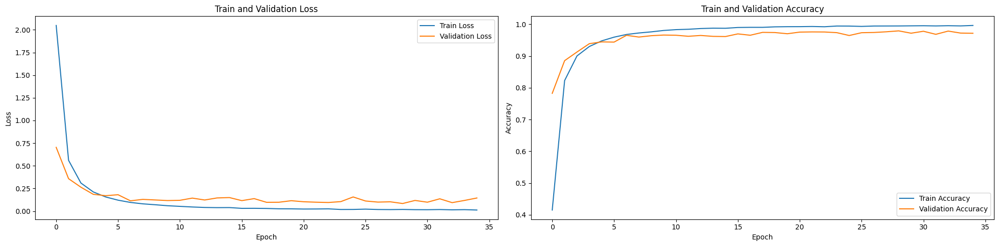

In [15]:
plt.figure(figsize = (20,5))
plt.subplot(1,2,1)
plt.title("Train and Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.plot(history.history['loss'],label="Train Loss")
plt.plot(history.history['val_loss'], label="Validation Loss")
# plt.xlim(0, 10)
# plt.ylim(0.0,1.0)
plt.legend()

plt.subplot(1,2,2)
plt.title("Train and Validation Accuracy")
plt.xlabel("Epoch")
plt.ylabel("Accuracy")
plt.plot(history.history['accuracy'], label="Train Accuracy")
plt.plot(history.history['val_accuracy'], label="Validation Accuracy")
# plt.xlim(0, 9.25)
# plt.ylim(0.75,1.0)
plt.legend()
plt.tight_layout() 

In [17]:
labels = []
predictions = []
for imgs,lbls in test_gen:
    labels.append(list(lbls.numpy()))
    predictions.append(tf.argmax(model.predict(imgs),1).numpy())

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━

In [18]:
predictions = list(itertools.chain.from_iterable(predictions))
labels = list(itertools.chain.from_iterable(labels))

print("Train Accuracy  : {:.2f} %".format(history.history['accuracy'][-1]*100))
print("Test Accuracy   : {:.2f} %".format(accuracy_score(labels, predictions) * 100))
print("Precision Score : {:.2f} %".format(precision_score(labels, predictions, average='micro') * 100))
print("Recall Score    : {:.2f} %".format(recall_score(labels, predictions, average='micro') * 100))

Train Accuracy  : 99.63 %
Test Accuracy   : 97.17 %
Precision Score : 97.17 %
Recall Score    : 97.17 %


<Figure size 2000x500 with 0 Axes>

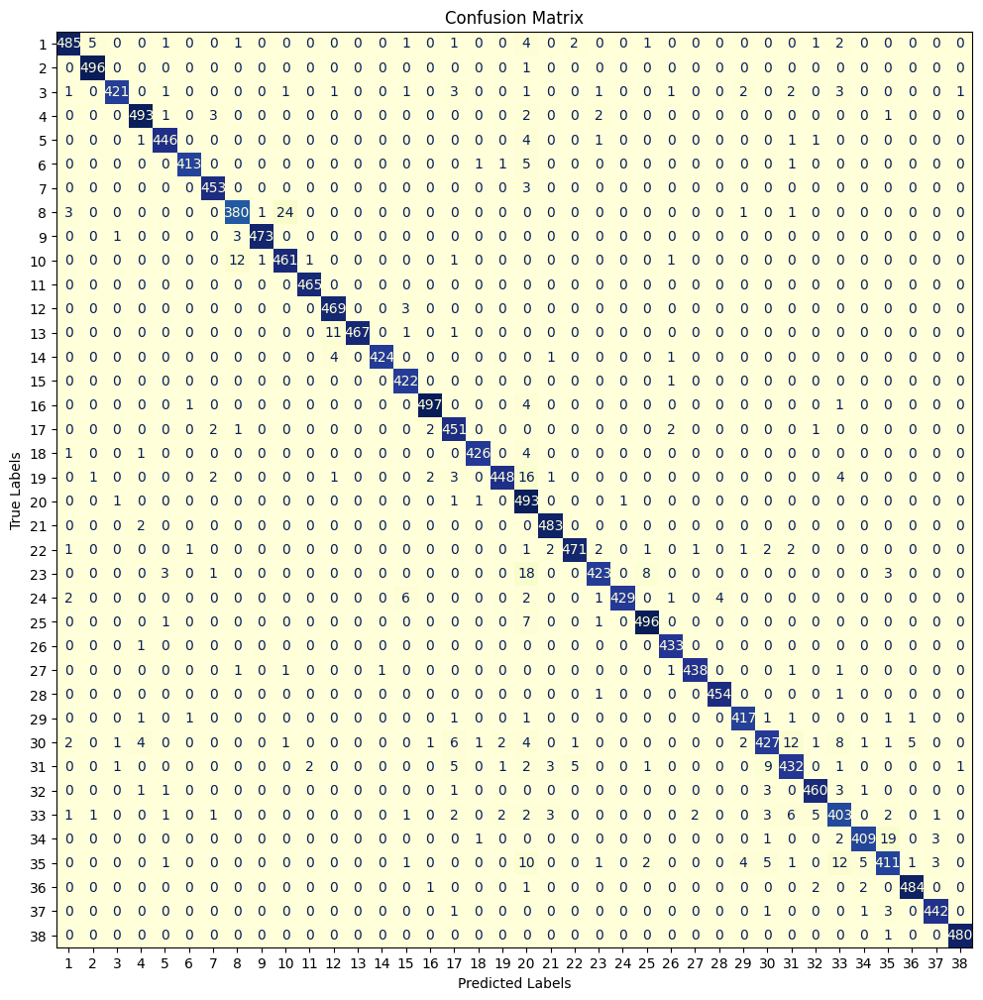

In [19]:
plt.figure(figsize= (20,5))
cm = confusion_matrix(labels, predictions)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,
                              display_labels=list(range(1,39)))
fig, ax = plt.subplots(figsize=(12,12))
disp.plot(ax=ax,colorbar= False,cmap = 'YlGnBu')
plt.title("Confusion Matrix")
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

In [20]:
def predict(model,img):
    img_array = tf.keras.preprocessing.image.img_to_array(img)
    img_array = tf.expand_dims(img_array, 0)
    
    predictions = model.predict(img_array)
    
    predicted_class = classes[np.argmax(predictions)]
    confidence = round(100* np.max(predictions),2)
    
    return predicted_class, confidence

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


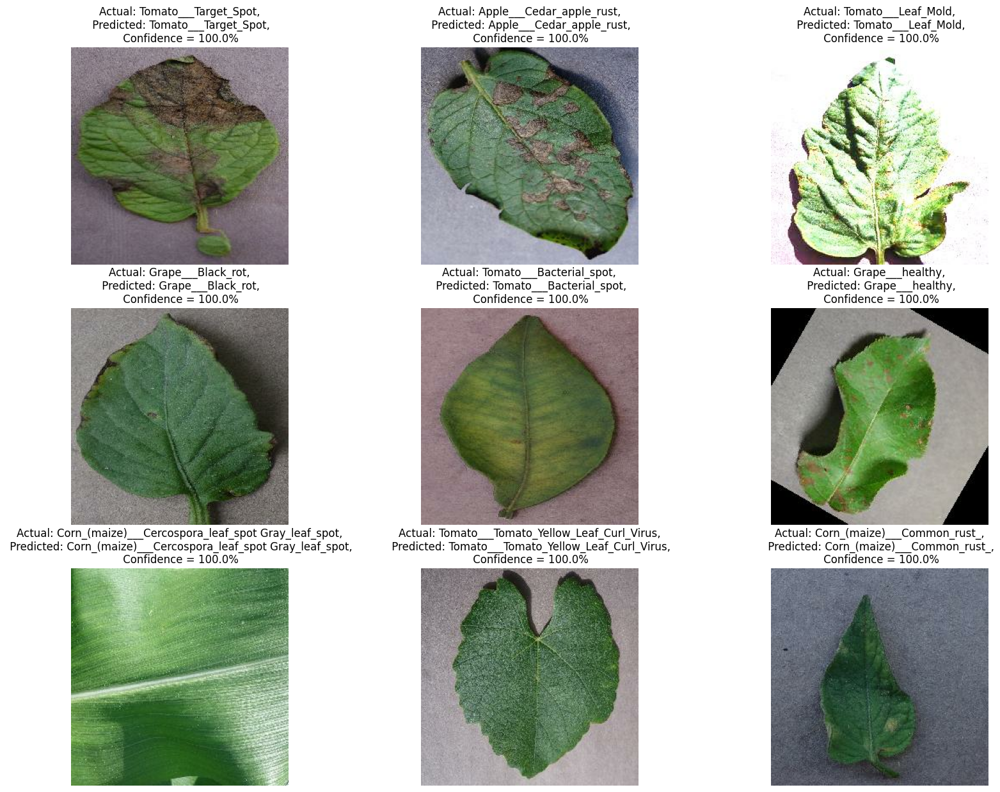

In [27]:
plt.figure(figsize=(20,15))
for images,labels in test_gen.take(1):
    for i in range(9):
        ax = plt.subplot(3,3, i+1)
        plt.imshow(images[i].numpy())
        
        pre_class, confidence = predict(model, images[i].numpy())
        
        plt.title(f'Actual: {classes[labels[i]]},\n Predicted: {pre_class},\n Confidence = {confidence}%')
        plt.axis("off")

In [34]:
model.save('/kaggle/working/PDD_CNN.h5')